In [15]:
using DifferentialEquations
using Plots
using LinearAlgebra

In [33]:
include("UsefulFunctions.jl")
include("Solvers.jl")
include("PlotFunctions.jl")
include("PointGenerators.jl")

PointsOnSphere (generic function with 2 methods)

In [17]:
θ, μ, β = 10, 28, 8/3
p = [θ, μ, β]
Δt = 0.1
N = 600

600

In [31]:
xint= [-50, 50]
dx = 10
yint = [-50, 50]
dy = 10
zint = [-30, 70]
dz = 10

initial_points = PointsInCuboid(dx, xint, dy, yint, dz, zint);

In [34]:
M1 = PointsSolutions(p,Δt,N,initial_points,RK4, 10)
M2 = PointsSolutions(p,Δt,N,initial_points,RK4, 20)
;


In [35]:
size(M1)

(1331,)

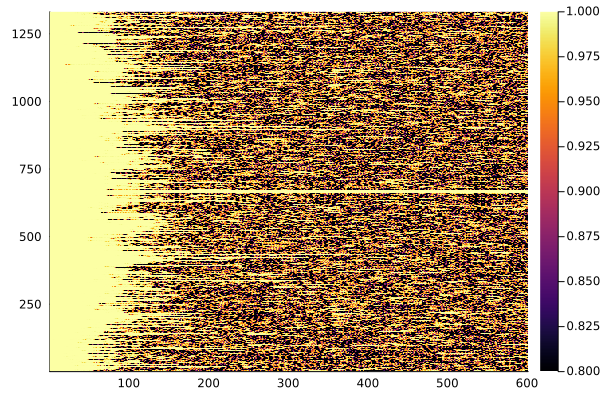

In [67]:

C1 = CorrelationMatrix(M1,M2,1331,600)

heatmap(C1,clim = (0.8,1))

In [ ]:
M3 = PointsSolutionsWorse(p,Δt,N,initial_points,RK4, 10)
M4 = PointsSolutionsWorse(p,Δt,N,initial_points,RK4, 20)
;


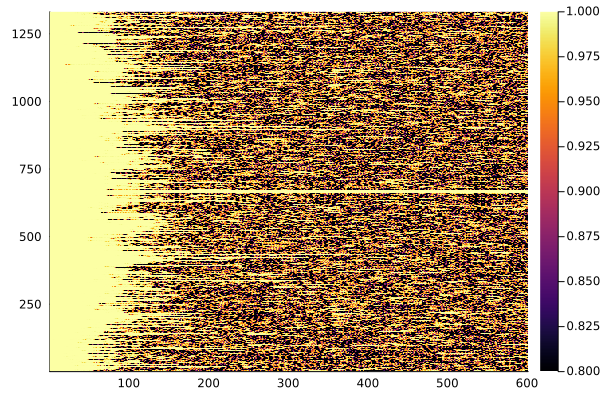

In [76]:
C2 = CorrelationMatrixWorse(M3,M4,1331,N+1)
heatmap(C2,clim = (0.8,1))

In [72]:
size(M4)

(1331,)

In [77]:
C1==C2

true

In [52]:
include("UsefulFunctions copy.jl")

EnergyFunction (generic function with 1 method)

In [58]:
a = 1:1:10
for i = a
    print(i)
end

12345678910

In [59]:
function PointsInCuboid(I₁,I₂,I₃)
    vec = zeros(3,size(I₁)[1]*size(I₂)[1]*size(I₃)[1])
    i = 1
    for x₁ = I₁
        for x₂ = I₂
            for x₃ = I₃
                vec[:,i] = [x₁, x₂, x₃]
                i = i + 1
            end
        end
    end
    return vec
end

PointsInCuboid (generic function with 2 methods)

In [62]:
I1 = -50:10:50
I2 = -30:10:70
n = PointsInCuboid(I1,I1,I2)
size(n)

(3, 1331)

In [63]:
M3 = PointsSolutions(p,Δt,N,n,RK4, 10)
M4 = PointsSolutions(p,Δt,N,n,RK4, 20)
;

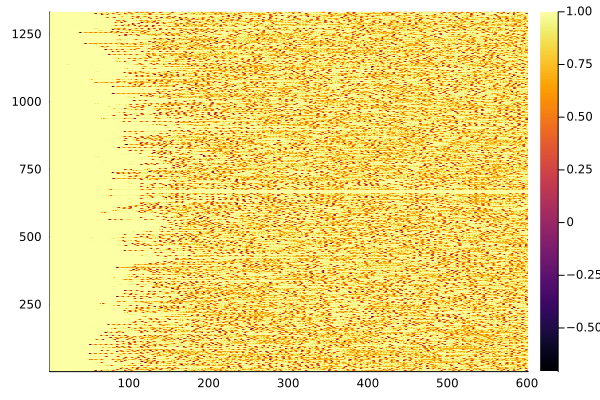

In [64]:
heatmap(CorrelationMatrix(M3,M4))

In [28]:
function PointsSolutions(p,Δt,N::Int64,initial_points,Solver, steps_per_Δt::Int64)
    solutions = zeros(3*size(initial_points)[2], N+1)
    for i = 1:size(initial_points)[2]
        x₀ = initial_points[:,i]
        X = LorenzSolutionFixedTimeStep(p, Δt/steps_per_Δt, N*steps_per_Δt, x₀, Solver)[:,1:steps_per_Δt:end]
        solutions[3*(i-1)+1:3*i,:] = X
    end
    return solutions
end

PointsSolutions (generic function with 1 method)

In [29]:
X = PointsSolutions(p,Δt,N,a,RK4, 10)

9×601 Matrix{Float64}:
 1.0   2.13311   6.54251  16.6848   …   3.15987   5.42114    9.14737
 1.0   4.47141  13.7311   27.1835       5.09357   8.29177   13.577
 1.0   1.1139    4.18019  26.2063      20.3912   18.1176    21.0016
 2.0   4.24303  12.1219   19.2818       1.30325   2.37343    5.16732
 2.0   8.819    23.3135   15.1789       1.84253   4.09021    9.3428
 1.0   2.14517  13.3074   45.9805   …  15.3309   12.2035    11.5173
 3.0   5.44299  14.564    17.7118      -1.97021  -4.8223   -11.3857
 2.0  11.0733   26.0612    7.37418     -3.67413  -9.20753  -19.8598
 1.0   3.01366  19.4367   47.7478       9.1341    8.85902   17.3898

In [25]:
X = LorenzSolutionFixedTimeStep(p, 0.01, 600, a[:,1], RK4)

3×601 Matrix{Float64}:
 1.0  1.01257   1.04882   1.10721   …  -10.1143   -9.93762  -9.74237
 1.0  1.25992   1.524     1.79831       -8.44998  -8.07288  -7.70717
 1.0  0.984891  0.973114  0.965159      30.9307   30.9342   30.8862